<a href="https://colab.research.google.com/github/psGitOrange/Walmart-Customer-Purchase-Behaviour-Analysis-using-CI-CLT/blob/main/Walmart_CI_CLT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Walmart

### **About Walmart**
Walmart is an American multinational retail corporation that operates a chain of supercenters, discount departmental stores, and grocery stores from the United States. Walmart has more than 100 million customers worldwide.

<img src="https://the1a.org/wp-content/uploads/sites/4/2023/12/GettyImages-1793799993-1500x984.jpg" alt="walmart_img" width="720"/>






## Business Problem

The Management team at Walmart Inc. wants to analyze the customer purchase behavior (specifically, purchase amount) against the customer’s gender and the various other factors to help the business make better decisions. They want to understand if the spending habits differ between male and female customers: Do women spend more on Black Friday than men? (Assume 50 million customers are male and 50 million are female).

### Dataset

The company collected the transactional data of customers who purchased products from the Walmart Stores during Black Friday. The dataset has the following features:
Dataset link: [Walmart_data.csv](https://d2beiqkhq929f0.cloudfront.net/public_assets/assets/000/001/293/original/walmart_data.csv?1641285094)

User_ID:	              User ID</br>
Product_ID:	            Product ID </br>
Gender:	                Sex of User </br>
Age:	                  Age in bins </br>
Occupation:	            Occupation(Masked) </br>
City_Category:	        Category of the City (A,B,C) </br>
StayInCurrentCityYears:	Number of years stay in current city </br>
Marital_Status:	        Marital Status </br>
ProductCategory:	      Product Category (Masked) </br>
Purchase:	              Purchase Amount </br>

## Basic Overview
Let us load Walmart data, and do some basic analysis using pandas, numpy with matplotlib, seaborn, plotly and y-data profiling

We will load the data set from the download link using `wget` (wget function retrieve files from http or ftp) function and save it as Walmart data.csv

In [ ]:
#Download walmart data csv file
!wget https://d2beiqkhq929f0.cloudfront.net/public_assets/assets/000/001/293/original/walmart_data.csv?1641285094 -O walmart_data.csv

--2024-08-10 14:50:15--  https://d2beiqkhq929f0.cloudfront.net/public_assets/assets/000/001/293/original/walmart_data.csv?1641285094
Resolving d2beiqkhq929f0.cloudfront.net (d2beiqkhq929f0.cloudfront.net)... 18.164.173.117, 18.164.173.18, 18.164.173.58, ...
Connecting to d2beiqkhq929f0.cloudfront.net (d2beiqkhq929f0.cloudfront.net)|18.164.173.117|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 23027994 (22M) [text/plain]
Saving to: ‘walmart_data.csv’

walmart_data.csv    100%[===================>]  21.96M   140MB/s    in 0.2s    

2024-08-10 14:50:15 (140 MB/s) - ‘walmart_data.csv’ saved [23027994/23027994]



In [ ]:
import pandas as pd
import numpy as np

In [ ]:
#
raw_df = pd.read_csv('./walmart_data.csv')
raw_df

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category,Purchase
0,1000001,P00069042,F,0-17,10,A,2,0,3,8370
1,1000001,P00248942,F,0-17,10,A,2,0,1,15200
2,1000001,P00087842,F,0-17,10,A,2,0,12,1422
3,1000001,P00085442,F,0-17,10,A,2,0,12,1057
4,1000002,P00285442,M,55+,16,C,4+,0,8,7969
...,...,...,...,...,...,...,...,...,...,...
550063,1006033,P00372445,M,51-55,13,B,1,1,20,368
550064,1006035,P00375436,F,26-35,1,C,3,0,20,371
550065,1006036,P00375436,F,26-35,15,B,4+,1,20,137
550066,1006038,P00375436,F,55+,1,C,2,0,20,365


In [ ]:
raw_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 550068 entries, 0 to 550067
Data columns (total 10 columns):
 #   Column                      Non-Null Count   Dtype 
---  ------                      --------------   ----- 
 0   User_ID                     550068 non-null  int64 
 1   Product_ID                  550068 non-null  object
 2   Gender                      550068 non-null  object
 3   Age                         550068 non-null  object
 4   Occupation                  550068 non-null  int64 
 5   City_Category               550068 non-null  object
 6   Stay_In_Current_City_Years  550068 non-null  object
 7   Marital_Status              550068 non-null  int64 
 8   Product_Category            550068 non-null  int64 
 9   Purchase                    550068 non-null  int64 
dtypes: int64(5), object(5)
memory usage: 42.0+ MB


In [ ]:
# finding null values
raw_df.isnull().sum() #no null/missing values

,0
User_ID,0
Product_ID,0
Gender,0
Age,0
Occupation,0
City_Category,0
Stay_In_Current_City_Years,0
Marital_Status,0
Product_Category,0
Purchase,0


In [ ]:
raw_df.columns

Index(['User_ID', 'Product_ID', 'Gender', 'Age', 'Occupation', 'City_Category',
       'Stay_In_Current_City_Years', 'Marital_Status', 'Product_Category',
       'Purchase'],
      dtype='object')

Using pd.read_csv we have loaded our data into a raw_df data frame
They are total 5.5 million entries. As mentioned earlier this is just a sample data set from Walmart Black Friday sales we have to consider a total of 50 million males and females as population number.

Using info(), we get to know they are 10 columns with an 5 object and 5 int type data type.
There are no null values as we can see using .isnull() function.

In [ ]:
#Converting categorical column having integer values to cat codes
cat_int_cols = ['Occupation', 'Marital_Status', 'Product_Category']

#Converting Categorical columns having object data type to cat codes
obj_cols = raw_df.select_dtypes('object').columns.to_list()
for col in cat_int_cols+obj_cols:
  raw_df[col] = raw_df[col].astype("category")

In [ ]:
raw_df.dtypes

,0
User_ID,int64
Product_ID,category
Gender,category
Age,category
Occupation,category
City_Category,category
Stay_In_Current_City_Years,category
Marital_Status,category
Product_Category,category
Purchase,int64


We are converting the integer column Occupation, Marital Status and Product Category into categorical type
Also converting object type columns into categorical type. We are using .astype() with function argument 'category' to convert them into categorical.

In [ ]:
raw_df['Purchase'].describe() #though only purchase is numerical other are more of a category

,Purchase
count,550068.000000
mean,9263.968713
std,5023.065394
min,12.000000
25%,5823.000000
50%,8047.000000
75%,12054.000000
max,23961.000000


Describe function on pulses column shows that, mean purchase amount is 9263 for this sample set while the standard deviation is 5023.

With minimum purchase amount of 12 and maximum of 23961

Median purchase amount is 8047 this shows that a data is right skewed as median is less than mean.

In [ ]:
object_columns = cat_int_cols+obj_cols
value_counts = {col: raw_df[col].value_counts() for col in object_columns}

# Print the value counts for each column
for col, counts in value_counts.items():
    print(f"Value counts for column '{col}':")
    print(counts ,end="\n\n")

Value counts for column 'Occupation':
Occupation
4     72308
0     69638
7     59133
1     47426
17    40043
20    33562
12    31179
14    27309
2     26588
16    25371
6     20355
3     17650
10    12930
5     12177
15    12165
11    11586
19     8461
13     7728
18     6622
9      6291
8      1546
Name: count, dtype: int64

Value counts for column 'Marital_Status':
Marital_Status
0    324731
1    225337
Name: count, dtype: int64

Value counts for column 'Product_Category':
Product_Category
5     150933
1     140378
8     113925
11     24287
2      23864
6      20466
3      20213
4      11753
16      9828
15      6290
13      5549
10      5125
12      3947
7       3721
18      3125
20      2550
19      1603
14      1523
17       578
9        410
Name: count, dtype: int64

Value counts for column 'Product_ID':
Product_ID
P00265242    1880
P00025442    1615
P00110742    1612
P00112142    1562
P00057642    1470
             ... 
P00068742       1
P00012342       1
P00162742       1
P0009

**They** are total 20 different categories in **Occupation** from 1-20.</br>
`Occupation Category: ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20']` </br>
These are all masked. 4, 0 and 7 being the most common occupation.

**Marital Status** has either `'1'` or `'0'` for `Married` and `Unmarried` or single respectively. There are more unmarried customers visiting Walmart then married.

They are 20 different **Product** Categories.</br>
`Product Category: ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20']` </br>
 These are also masked with highest product sale for category 5, 1 and 8. These cover most of the product being purchased on black friday sale.

There are total `3,631` unique **Product IDs**. These are identifiers for the product available at Walmart during sale.

There are two **Gender** categories `M` for `Male` and `F` for `Female` with male having purchase records of 414K and female around 135K.

There are 7 **Age** Categories.</br>
`Age Category: ['0-17', '18-25', '26-35', '36-45', '46-50', '51-55', '55+']` </br>
The highest being age group 26 to 35. There are total 219K record of these purchases on Sale.

There are three **City Categories** </br>
City Category:['A', 'B', 'C'] </br>
With most of the customers residing in city B. i.e. 231K of them.

Value count for customer's **Stay in current city in years** has five categories.</br>
`Stayed Category: ['0', '1', '2', '3', '4+'] in years`.</br>
Most of the customer have stayed in the current city for 1 year. i.e. 193K of them. With Customer with 2 years stay are 101K, second most appearing in black friday sale.


## Males vs Females

We will filter out males and females data, and store it in new variable using copy


In [ ]:
females_df = raw_df[raw_df['Gender']=="F"].copy()
females_df.head()

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category,Purchase
0,1000001,P00069042,F,0-17,10,A,2,0,3,8370
1,1000001,P00248942,F,0-17,10,A,2,0,1,15200
2,1000001,P00087842,F,0-17,10,A,2,0,12,1422
3,1000001,P00085442,F,0-17,10,A,2,0,12,1057
14,1000006,P00231342,F,51-55,9,A,1,0,5,5378


In [ ]:
males_df = raw_df[raw_df['Gender']=="M"].copy()
males_df.head()

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category,Purchase
4,1000002,P00285442,M,55+,16,C,4+,0,8,7969
5,1000003,P00193542,M,26-35,15,A,3,0,1,15227
6,1000004,P00184942,M,46-50,7,B,2,1,1,19215
7,1000004,P00346142,M,46-50,7,B,2,1,1,15854
8,1000004,P0097242,M,46-50,7,B,2,1,1,15686


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [ ]:
!pip install ydata-profiling
from ydata_profiling import ProfileReport

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 356.2/356.2 kB 6.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 17.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 14.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 17.6 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=ce02461267d35319544649620792fdb4a13dba9c199fc1e274949c1f5ac7daa2
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [ ]:
ProfileReport(females_df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
ProfileReport(males_df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

For some quick analysis on the filtered data we used `y-data profiling`. It gives a preliminary analysis on the data. </br>

First we get overview on **distribution** of **all** the variables.</br>

Second it gives **interaction** or **pair plots** between two integer variables, here we can see the **hexagonal** heatmap has darker shades near **8000** between purchase and user id for both females and males indicating that more transaction were made for that value.</br>

Third it gives **correlation** matrix between all the variables, here we can see "Age", "Occupation" and "Maritatal Status" are closely correlated or positivity correlated.</br>

It also gives count of **missing values** in the data frame and lastly in gives representation or a **sample data** frame to look at values inside each variable.

### Q1) Are women spending more money per transaction than men? Why or Why not?





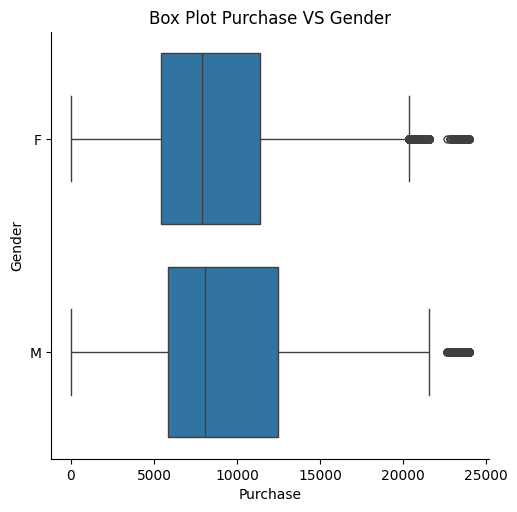

In [ ]:
sns.catplot(raw_df, x='Purchase', y='Gender', kind='box')
plt.title("Box Plot Purchase VS Gender")
plt.show()

In [ ]:
print(females_df.Purchase.mean())
print(males_df.Purchase.mean())

8734.565765155476
9437.526040472265


In [ ]:
print(females_df.Purchase.std())
print(males_df.Purchase.std())

4767.233289291458
5092.18620977797


**Box plot** shows that **median** female purchase value is **less** than males. **Mean** is **8734.5** and **9437.5** respectively.
This show that on an average **females** are spending less than males per transaction

The **standard deviation** is too **high** 4767 and 5092.4 for females and males respectively.
The spread in transaction amount is very high, starting from 12 to 23961 dollars.

In [ ]:
fig = px.histogram(raw_df, x="Purchase",color="Gender", marginal='box',
                   title="Purchase and Gender")
fig.update_layout(bargap=0.2)
fig.show()

/usr/local/lib/python3.10/dist-packages/plotly/express/_core.py:1971: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby(required_grouper, sort=False)  # skip one_group groupers


**Histogram** using plotly can be used to see the **spread** in transaction amount for both males and females with a box plot on top.
Tough the distribution is almost **same** for both variables.

Histogram shows there are **more males** transaction then female in a dataset as seen earlier at value counts.

In [ ]:
#outlier detection
Q1 = females_df['Purchase'].quantile(0.25)
Q3 = females_df['Purchase'].quantile(0.75)

# Calculate IQR
IQR = Q3 - Q1

# Identify outliers
outliers = females_df['Purchase'][(females_df['Purchase'] < (Q1 - 1.5 * IQR)) | (females_df['Purchase'] > (Q3 + 1.5 * IQR))]
len(outliers)

2065

In [ ]:
#outlier detection
Q1 = males_df['Purchase'].quantile(0.25)
Q3 = males_df['Purchase'].quantile(0.75)

# Calculate IQR
IQR = Q3 - Q1

# Identify outliers
outliers = males_df['Purchase'][(males_df['Purchase'] < (Q1 - 1.5 * IQR)) | (males_df['Purchase'] > (Q3 + 1.5 * IQR))]
len(outliers)

1812

In [ ]:
outliers.sample(4)

,Purchase
13950,23702
28168,23042
437770,20520
81309,23756


There are total **2065 outliers** in **females** purchase data set and **1812** in **males** purchase data set.

This means there's a higher percentage of outliers in female then males. All the outliers are on the right side greater than 20k has seen inbox plot.

In [ ]:
from scipy.stats import f_oneway # Numeric vs categorical for many categories
from scipy.stats import ttest_ind # Numeric vs categorical

from statsmodels.graphics.gofplots import qqplot # Check Normal distribution

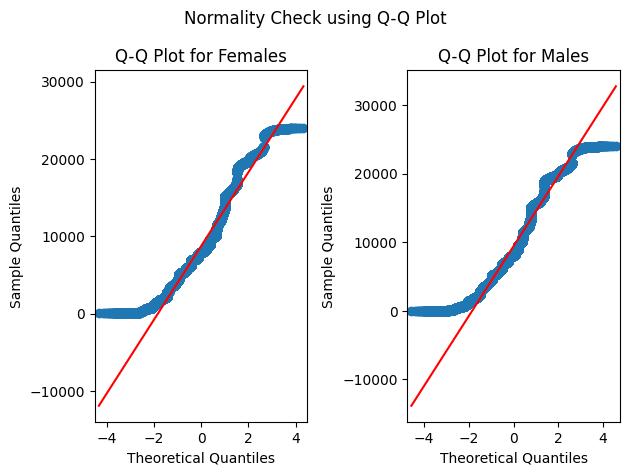

In [ ]:
# checking normal distribution
fig, (ax1, ax2) = plt.subplots(1, 2)
qqplot(females_df["Purchase"], line="s", ax=ax1)
qqplot(males_df["Purchase"], line="s", ax=ax2)
plt.suptitle('Normality Check using Q-Q Plot')
ax1.set_title("Q-Q Plot for Females")
ax2.set_title("Q-Q Plot for Males")
plt.tight_layout()
plt.show()

Using **QQ Plot** for **normality** check shows that it aligns with the expected quantile but it has outliers on both the tails for both males and females dataframe.

In [ ]:
#H0 = There is no significant difference in mean purchase of males and females
#H1 = Mean purchase of females is less than males

t_stat, pvalue = ttest_ind(females_df['Purchase'], males_df['Purchase'], alternative = "less")
print(f't_stat: {t_stat}, pval: {pvalue}')

if pvalue < 0.05:
  print("Rejecting null hypothesis. Mean purchase of females is less than males")
else:
  print('Failed to reject null hypothesis. There is no significant difference in mean purchase of males and females')

t_stat: -44.837957934353966, pval: 0.0
Rejecting null hypothesis. Mean purchase of females is less than males


Independent **t-test** shows that there is a **significant difference** between male and female **mean purchases**. It also tells us, when conducted a **left tailed** test using alternative equals less, that mean purchase of **female** is **less** than **males**.

### Q2) Confidence intervals and distribution of the mean of the expenses by female and male customers

We need to group by User_ID first to get the total amount spent/ purchase done by users on Black friday sale, then we can get there Avg spend.

Removing Product ID, as there are too many different products sold. This will require a dedicated analysis.
Also removing Product Category, the values are masked, we wont be able to make much inference out of it.   

In [ ]:
f_df =females_df.groupby('User_ID').agg({
    'Gender': 'first', 'Age': 'first', 'Occupation': 'first',
    'City_Category': 'first', 'Stay_In_Current_City_Years': 'first',
    'Marital_Status': 'first', 'Purchase': 'mean' }).reset_index()
f_df.sample(5)

,User_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Purchase
67,1000219,F,26-35,4,A,0,0,7985.045455
350,1001301,F,26-35,2,C,1,1,10963.200000
872,1003249,F,26-35,4,C,2,0,8592.206897
1528,1005661,F,26-35,15,C,1,1,9904.632911
1238,1004750,F,26-35,0,A,2,0,9010.571429


In [ ]:
fig = px.histogram(f_df, x="Purchase", marginal='box',
                   title="Females' Mean Expenses")
fig.update_layout(bargap=0.2)
fig.show()

In [ ]:
m_df = males_df.groupby('User_ID').agg({
    'Gender': 'first', 'Age': 'first', 'Occupation': 'first',
    'City_Category': 'first', 'Stay_In_Current_City_Years': 'first',
    'Marital_Status': 'first', 'Purchase': 'mean'}).reset_index()
m_df.sample(5)

,User_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Purchase
1381,1001941,M,36-45,17,A,1,0,7591.863029
3748,1005285,M,18-25,4,A,1,0,9384.862069
1367,1001921,M,55+,12,C,2,0,11588.318182
3310,1004638,M,26-35,4,B,1,0,8536.105263
1261,1001778,M,18-25,4,B,1,0,9039.618590


In [ ]:
fig = px.histogram(m_df, x="Purchase", marginal='box',
                   title="Males' Mean Expenses")
fig.update_layout(bargap=0.2)
fig.show()

In [ ]:
## pop avg - with 95% CI
import numpy as np
from scipy.stats import norm

In [ ]:
f_sample_mean = f_df.Purchase.mean()
f_sample_std = f_df.Purchase.std()
f_sample_size = len(f_df.Purchase)

m_sample_mean = m_df.Purchase.mean()
m_sample_std = m_df.Purchase.std()
m_sample_size = len(m_df.Purchase)

In [ ]:
print(f'females sample mean: {f_sample_mean}, males sample mean: {m_sample_mean}')
print(f'females sample std deviation: {f_sample_std}, males sample std deviation: {m_sample_std}')
print(f'females sample size: {f_sample_size}, males sample size: {m_sample_size}')

females sample mean: 8965.19846393646, males sample mean: 9806.867524226629
females sample std deviation: 1705.615507574696, males sample std deviation: 1906.3961057186173
females sample size: 1666, males sample size: 4225


**Mean Expenses**

**Females** mean purchase lies around **8965** and for **Males** is **9806**. This is after aggregating the user ID with their mean purchases. This gives the the mean purchase of sample provided for both males and females.


In [ ]:
#we can take sample std deviation instead of population std when not given
f_se = f_sample_std/np.sqrt(f_sample_size)
print(f'Standard error: {f_se}')

norm.interval(confidence=0.95, loc=f_sample_mean, scale=f_se)

Standard error: 41.78723519231178


(8883.296987946023, 9047.099939926897)

Using norm.interval function with `0.95` confidence Interval and after calculating standard error, we get the **population mean** purchase of **females** is between **8883 - 9047** dollars.

In [ ]:
m_se = m_sample_std/np.sqrt(m_sample_size)
print(f'Standard error: {m_se}')

print(norm.interval(confidence=0.95, loc=m_sample_mean, scale=m_se))

Standard error: 29.329170857209498
(9749.383405650076, 9864.351642803182)


Using the above same calculations, we get the confidence interval for **population mean** purchase of **males** is between **9749 - 9864** dollars.

### Q3) Are confidence intervals of average male and female spending overlapping? How can Walmart leverage this conclusion to make changes or improvements?

CLT

we are performing bootstrapping method here,
Assumption is that there are 100M users, 50M Females and 50M Males.
We will be taking samples out of the 500K sample data provided to us.

We will be keeping the sample size constant i.e. 10000 samples to get mean of means for all other variations.

In [ ]:
def get_samples_purchase_mean(df, n=300):  # number of samples
  sample_indices = np.random.choice(df.index, size=n, replace=False)
  sample_purchases = df.loc[sample_indices].Purchase
  return sample_purchases.mean()

In [ ]:
%%time
f_sample_purchases = [get_samples_purchase_mean(females_df) for i in range(10000)]
# sample_purchases

px.histogram(x=f_sample_purchases, marginal="box",
             title="Females' Sample Purchase Means with 300 Sample Size")

CPU times: user 38.2 s, sys: 74.6 ms, total: 38.2 s
Wall time: 42.4 s


As mentioned in CLT, we are getting a normal distribution out of mean of sample means.

In [ ]:
# function to print multiple confidence intervals.
def print_ci(sample_purchases):
  samples_mean = np.mean(sample_purchases)
  print(f'sample mean: {samples_mean}')

  samples_std = np.std(sample_purchases)
  print(f'sample std deviation: {samples_std}')

  samples_size = 10000 # no. of sampling performed
  print(f'sample size: {samples_size}')

  samples_se = samples_std/np.sqrt(samples_size)
  print(f'Standard error: {samples_se}')

  print("Average expense per transaction with:")
  for ci in [90,95,99]:
    print(f"{ci}% Confidence Interval:",
          norm.interval(confidence=ci/100, loc=samples_mean, scale=samples_se))

In [ ]:
print_ci(f_sample_purchases)

sample mean: 8733.464251
sample std deviation: 273.6126738116475
sample size: 10000
Standard error: 2.7361267381164747
Average expense per transaction with:
90% Confidence Interval: (8728.96372301101, 8737.96477898899)
95% Confidence Interval: (8728.101541136153, 8738.826960863846)
99% Confidence Interval: (8726.416455569735, 8740.512046430264)


To get mean purchase value for each sample we used a sample size of 300, and 10000 such sample to get mean purchase of means.

Mean female purchases is 8733, the standard deviation of 273. </br>
With 99% confidence, we  can say that the population mean will be between 8726 and 8740 dollars for females

In [ ]:
%%time
m_sample_purchases = [get_samples_purchase_mean(males_df) for i in range(10000)]
# sample_purchases

px.histogram(x=m_sample_purchases, marginal="box",
             title="Males' Sample Purchase Means with 300 Sample Size")

CPU times: user 1min 57s, sys: 298 ms, total: 1min 57s
Wall time: 2min 9s


In [ ]:
print_ci(m_sample_purchases)

sample mean: 9437.341369333333
sample std deviation: 293.2335092020397
sample size: 10000
Standard error: 2.932335092020397
Average expense per transaction with:
90% Confidence Interval: (9432.518107321786, 9442.16463134488)
95% Confidence Interval: (9431.59409816237, 9443.088640504297)
99% Confidence Interval: (9429.788174675483, 9444.894563991184)


For sample size 300 and 10000 sample means,It gave mean male purchase value of 9437 with standard deviation of 293.</br>
With 99% confidence, we can say that the population mean will be between 9429 and 9444 dollars for males.




> **Repeating** the same for sample size **3,000** and **30,000** sample size



In [ ]:
#lets increase the sample size
%%time
f_sample_purchases = [get_samples_purchase_mean(females_df, n=3000) for i in range(10000)]
# sample_purchases

px.histogram(x=f_sample_purchases, marginal="box",
             title="Females' Sample Purchase Means with 3000 Sample Size")

CPU times: user 39.9 s, sys: 76.7 ms, total: 39.9 s
Wall time: 40.2 s


In [ ]:
print_ci(f_sample_purchases)

sample mean: 8735.762526533334
sample std deviation: 87.32295892631412
sample size: 10000
Standard error: 0.8732295892631412
Average expense per transaction with:
90% Confidence Interval: (8734.326191676273, 8737.198861390394)
95% Confidence Interval: (8734.051027988144, 8737.474025078523)
99% Confidence Interval: (8733.513236168583, 8738.011816898084)


For sample size 3000 and 10000 sample means

We got mean Female purchases to be about 8735 dollar.</br>
Here the standard deviation, for females has decrease to 87.32 dollar.</br>
With 99% confidence, we can say that the population mean will be between 8733 and 8738 for females

In [ ]:
%%time
m_sample_purchases = [get_samples_purchase_mean(males_df, n=3000) for i in range(10000)]
# sample_purchases

px.histogram(x=m_sample_purchases, marginal="box",
             title="Males' Sample Purchase Means with 3000 Sample Size")

CPU times: user 2min 3s, sys: 289 ms, total: 2min 3s
Wall time: 2min 11s


In [ ]:
print_ci(m_sample_purchases)

sample mean: 9437.559738099999
sample std deviation: 92.38400538296838
sample size: 10000
Standard error: 0.9238400538296838
Average expense per transaction with:
90% Confidence Interval: (9436.040156436735, 9439.079319763263)
95% Confidence Interval: (9435.749044867018, 9439.37043133298)
99% Confidence Interval: (9435.180083817551, 9439.939392382446)


For sample size 3000 and 10000 sample means

Mean Male purchases is about 9437.55 dollar.</br>
Similarly for Males, the standard deviation decreased to 92.38.</br>
With 99% confidence, we can say that the population mean will be between 9435 and 9439 for males.

In [ ]:
#sample size 30000
%%time
f_sample_purchases = [get_samples_purchase_mean(females_df, n=30000) for i in range(10000)]
# sample_purchases

px.histogram(x=f_sample_purchases, marginal="box",
             title="Females' Sample Purchase Means with 30000 Sample Size")

CPU times: user 1min 13s, sys: 112 ms, total: 1min 13s
Wall time: 1min 14s


In [ ]:
print_ci(f_sample_purchases)

sample mean: 8734.545816963335
sample std deviation: 24.30194346533216
sample size: 10000
Standard error: 0.24301943465332163
Average expense per transaction with:
90% Confidence Interval: (8734.146085564826, 8734.945548361844)
95% Confidence Interval: (8734.069507623872, 8735.022126302798)
99% Confidence Interval: (8733.919840382223, 8735.171793544447)


For sample size 30000 and 10000 sample means

We got mean Female purchases to be about 8734 dollar.</br>
Standard deviation further decreased for females to 24.3 dollar.</br>
With 99% confidence, we can say that the population mean will be between 8733 and 8735 for females.

In [ ]:
%%time
m_sample_purchases = [get_samples_purchase_mean(males_df, n=30000) for i in range(10000)]
# sample_purchases

px.histogram(x=m_sample_purchases, marginal="box",
             title="Males' Sample Purchase Means with 30000 Sample Size")

CPU times: user 3min 2s, sys: 307 ms, total: 3min 2s
Wall time: 3min 5s


In [ ]:
print_ci(m_sample_purchases)

sample mean: 9437.486916460002
sample std deviation: 28.2912958549635
sample size: 10000
Standard error: 0.282912958549635
Average expense per transaction with:
90% Confidence Interval: (9437.02156605402, 9437.952266865985)
95% Confidence Interval: (9436.932417250486, 9438.041415669519)
99% Confidence Interval: (9436.758180971017, 9438.215651948987)


For sample size 30000 and 10000 sample means

Mean Male purchases is about 9437.48 dollar.</br>
Similarly for Males, the standard deviation further decreased to 28.29.</br>
With 99% confidence, we can say that the population mean will be between 9436 and 9438 for males.

### Conclusion on Males vs Females.

Females and Males **mean** purchase values are different i.e. **8734.5 and 9437.5**, there is no overlap in mean purchases.</br>
**95% CI** for **mean** value,</br>
For **Females [8734-8737] dollar**, for samlple size 3000 </br>
For **Males [9435-9439] dollar**, for samlple size 3000

so we can expect the ones spending 8734-8737 would be females,
and between 9435-9439 would be males.

(*Large sample sizes improve mean stability and precision due to the Law of Large Numbers, but if the sampling process is biased, the mean of these samples might still be skewed.*

*Hence we considered mean values correspoding to 3000 sample size to get population mean estimate.*)

The **population mean intervals** and **standard deviation** **decreased** as we increased sample size from **300 to 3,000 to 30,000**.

we dont know, the **product** categories, they have been masked
we can try on any product the same steps to get the **mean amount spent** by males and females respectively.

If the intervals coincide we can expect both males and females to spend equal amount on the particular product.

## Married vs Single
We will consider Customer is Married for the entries 1 in Marital_Status and Not Married/Single for entries 0.

In [ ]:
couples_df = raw_df[raw_df['Marital_Status']==1].copy()
couples_df.head()

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category,Purchase
6,1000004,P00184942,M,46-50,7,B,2,1,1,19215
7,1000004,P00346142,M,46-50,7,B,2,1,1,15854
8,1000004,P0097242,M,46-50,7,B,2,1,1,15686
9,1000005,P00274942,M,26-35,20,A,1,1,8,7871
10,1000005,P00251242,M,26-35,20,A,1,1,5,5254


In [ ]:
couples_df.shape

(225337, 10)

In [ ]:
singles_df = raw_df[raw_df['Marital_Status']==0].copy()
singles_df.head()

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category,Purchase
0,1000001,P00069042,F,0-17,10,A,2,0,3,8370
1,1000001,P00248942,F,0-17,10,A,2,0,1,15200
2,1000001,P00087842,F,0-17,10,A,2,0,12,1422
3,1000001,P00085442,F,0-17,10,A,2,0,12,1057
4,1000002,P00285442,M,55+,16,C,4+,0,8,7969


In [ ]:
singles_df.shape

(324731, 10)

In [ ]:
print(couples_df.Purchase.mean())
print(singles_df.Purchase.mean())

9261.174574082374
9265.907618921507


In [ ]:
print(couples_df.Purchase.std())
print(singles_df.Purchase.std())

5016.897377793055
5027.347858674449


In [ ]:
fig = px.histogram(raw_df, x="Purchase", color="Marital_Status", marginal='box',
                   title="Purchase and Marital Status")
fig.update_layout(bargap=0.2)
fig.show()

**Box plot** shows that **median** Couples purchase value is **nearly equal** to that of Singles. **Mean** is **9261.17** and **9265.9** respectively.
This shows that on an average Couples are spending equal to that of Singles per transaction.

The **standard deviation** is too **high** **5016.89 and 5027.34** for Couples and Singles respectively.

**Histogram** using plotly can be used to see the **spread** in transaction amount for both Couples and Singles with a box plot on top.
Tough the distribution is almost **same** for both variables.

Histogram shows there are **more Singles** transaction then Couples in a dataset about **100K** more transaction done by singles.

In [ ]:
t_stat, pvalue = ttest_ind(couples_df['Purchase'], singles_df['Purchase'], alternative = "two-sided")
print(f't_stat: {t_stat}, pval: {pvalue}')

if pvalue < 0.05 :
  print("Rejecting null hypothesis. There is a significance difference \
in mean purchase of Married and Single customers")
else:
   print("Failed to reject null hypothesis. There is no significance difference \
in mean purchase of Married and Single customers")

t_stat: -0.3436698055440526, pval: 0.7310947525758316
Failed to reject null hypothesis. There is no significance difference in mean purchase of Married and Single customers


Independent **t-test** shows that there is a **significant difference** between Couples and Singles **mean purchases**. It also tells us, when conducted a **two tailed** test using alternative equals two-sided, that mean purchase of **Couples** is **equal** to **Singles**.

In [ ]:
c_sample_mean = couples_df.Purchase.mean()
c_sample_std = couples_df.Purchase.std()
c_sample_size = len(couples_df.Purchase)

s_sample_mean = singles_df.Purchase.mean()
s_sample_std = singles_df.Purchase.std()
s_sample_size = len(singles_df.Purchase)

In [ ]:
c_se = c_sample_std/np.sqrt(c_sample_size)
print(f'Standard error: {c_se}')

print(norm.interval(confidence=0.95, loc=c_sample_mean, scale=c_se))

Standard error: 10.568636561021286
(9240.460427057078, 9281.888721107669)


**Standard error** for couples mean purchase value is **10.56** dollars in this sample data set.

Using norm.interval function with `0.95` confidence Interval and after calculating standard error, we get the **population mean** purchase of **Couples** is between **9240.5 - 9281.9** dollars.

In [ ]:
s_se = s_sample_std/np.sqrt(s_sample_size)
print(f'Standard error: {s_se}')

print(norm.interval(confidence=0.95, loc=s_sample_mean, scale=s_se))

Standard error: 8.822203301293774
(9248.61641818668, 9283.198819656332)


Similarly **standard error** for singles mean purchase value is **8.82** dollars.

Using norm.interval function with `0.95` confidence Interval and after calculating standard error, we get the **population mean** purchase of **Singles** is between **9248.6 - 9283.2** dollars.

In [ ]:
%%time
c_sample_purchases = [get_samples_purchase_mean(couples_df) for i in range(10000)]
# sample_purchases

px.histogram(x=c_sample_purchases, marginal="box",
             title="Couples' sample purchase for 300 sample size")

CPU times: user 1min 9s, sys: 243 ms, total: 1min 9s
Wall time: 1min 16s


In [ ]:
print_ci(c_sample_purchases)

sample mean: 9260.859965000001
sample std deviation: 290.60957716770275
sample size: 10000
Standard error: 2.9060957716770277
Average expense per transaction with:
90% Confidence Interval: (9256.07986282969, 9265.640067170312)
95% Confidence Interval: (9255.16412195189, 9266.555808048113)
99% Confidence Interval: (9253.374358352396, 9268.345571647607)


Couples' Mean purchases per transaction is 9260.9 dollars.</br>
Here the standard deviation, for Couples is 290.6 dollar.</br>
With 95% confidence, we can say that the population mean will be between 9255 and 9266 for Couples




In [ ]:
s_sample_purchases = [get_samples_purchase_mean(singles_df) for i in range(10000)]
# sample_purchases

px.histogram(x=s_sample_purchases, marginal="box",
             title="Singles' sample purchase for 300 sample size")

In [ ]:
print_ci(s_sample_purchases)

sample mean: 9264.597333
sample std deviation: 288.18457238816274
sample size: 10000
Standard error: 2.8818457238816273
Average expense per transaction with:
90% Confidence Interval: (9259.85711860876, 9269.33754739124)
95% Confidence Interval: (9258.94901917219, 9270.245646827809)
99% Confidence Interval: (9257.174190336118, 9272.020475663881)


Singles' Mean purchases per transaction is 9264.6 dollars.</br>
Here the standard deviation, for Couples is 288.2 dollar.</br>
With 95% confidence, we can say that the population mean will be between 9258 and 9270 for Singles

In [ ]:
%%time
c_sample_purchases = [get_samples_purchase_mean(couples_df, n=3000) for i in range(10000)]
# sample_purchases

px.histogram(x=c_sample_purchases, marginal="box",
             title="Couples' sample purchases for 3000 sample size")

CPU times: user 1min 19s, sys: 190 ms, total: 1min 19s
Wall time: 1min 27s


In [ ]:
print_ci(c_sample_purchases)

sample mean: 9261.650806433336
sample std deviation: 91.1924132922208
sample size: 10000
Standard error: 0.9119241329222081
Average expense per transaction with:
90% Confidence Interval: (9260.150824715794, 9263.150788150877)
95% Confidence Interval: (9259.863467976174, 9263.438144890497)
99% Confidence Interval: (9259.30184552914, 9263.999767337531)


For sample size 3000 and 10000 sample means

We got mean Couples purchases to be about 9261.6 dollar.</br>
Here the standard deviation, for Couples has decrease to 91.2 dollar.</br>
With 95% confidence, we can say that the population mean will be between 9259 and 9263 for Couples

In [ ]:
%%time
s_sample_purchases = [get_samples_purchase_mean(singles_df, n=3000) for i in range(10000)]
# sample_purchases

px.histogram(x=s_sample_purchases, marginal="box",
             title="Singles' sample purchases for 3000 sample size")

CPU times: user 2min 6s, sys: 361 ms, total: 2min 6s
Wall time: 2min 25s


In [ ]:
print_ci(s_sample_purchases)

sample mean: 9265.835584933335
sample std deviation: 91.089130182055
sample size: 10000
Standard error: 0.91089130182055
Average expense per transaction with:
90% Confidence Interval: (9264.337302071777, 9267.333867794892)
95% Confidence Interval: (9264.050270787935, 9267.620899078735)
99% Confidence Interval: (9263.489284425757, 9268.181885440912)


For sample size 3000 and 10000 sample means

We got mean Singles purchases to be about 9265.6 dollar.</br>
Here the standard deviation, for Couples has decrease to 91.1 dollar.</br>
With 95% confidence, we can say that the population mean will be between 9264 and 9267 for Samples.

### Conclusion:
Couples and Singles **mean** purchase values are almost equal i.e. **9261.6 and 9265.8** respectively, there is overlap in mean purchases between them.</br>
**95% CI** for **mean** value,</br>
For **Couples [9259-9263] dollar**, for samlple size 3000 </br>
For **Singles [9264-9267] dollar**, for samlple size 3000

It is difficult to differentiate between user's marital status based on mean purchase value. As the confidence interval are very colse to each other and overlapping.

Here also **population mean intervals** and **standard deviation** **decreased** as we increased sample size from **300 to 3,000.

## Age
They are 7 age categories given in the data frame but we are trying to bring it down to 5 categories.

Converting the age group between (36 to 45 and 46 to 50) to 36 to 50 and age group from (51 to 55 and 55 +) to 51 +.

In [ ]:
raw_df.Age.unique()

array(['0-17', '55+', '26-35', '46-50', '51-55', '36-45', '18-25'],
      dtype=object)

In [ ]:
age_map = {"36-45": "36-50", "46-50": "36-50",
           "51-55": "51+", "55+": "51+"
}

In [ ]:
raw_df2 = raw_df.copy()
raw_df2['Age'] = raw_df['Age'].replace(age_map)
raw_df2.Age.unique()

array(['0-17', '51+', '26-35', '36-50', '18-25'], dtype=object)

We made a **dictionary** to **map** age groups as specified above. **Replace** function is gonna replace all the values matching with the key value of the dictionary.

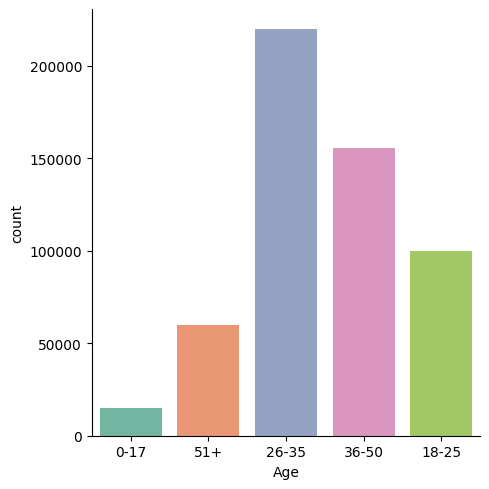

In [ ]:
sns.catplot(data=raw_df2, x="Age", kind='count',
            hue="Age", palette='Set2')
plt.show()

The count plot shows that **most** of our customers are having age group between **26 to 35**. This was seen at the start using value counts function as well.
Then age group **36 to 50** and **18 to 25** are **second** and **third** most visiting customers respectively.

In [ ]:
fig = px.histogram(raw_df2, x="Purchase", color="Age", marginal='box',
                   title="Purchase and Marital Status")
fig.update_layout(bargap=0.2)
fig.show()

**Box plot** shows that **median** Couples purchase value is **nearly equal** to that of Singles. **Mean** is **9261.17** and **9265.9** respectively.
This shows that on an average Couples are spending equal to that of Singles per transaction.

The **standard deviation** is too **high** **5016.89 and 5027.34** for Couples and Singles respectively.

**Histogram** using plotly can be used to see the **spread** in transaction amount for both Couples and Singles with a box plot on top.
Tough the distribution is almost **same** for both variables.

Histogram shows there are **more Singles** transaction then Couples in a dataset about **100K** more transaction done by singles.

The **Box plot** shows that the **median** values for age group **0 to 17** is the **lowest** median purchase value i.e.**7986** dollars
And the **highest** **median** purchase value is **8122** for age group **51+**.</br>
After looking closely it can be seen that the mean purchase value **increases as** the **age group increases**.
For age group **18 to 25** median is **8027** dollars, for age group **26 to 35** median is **8030** and for age group **36 to 50** median is **8053** dollars.

**Histogram** shows us the spread in transaction amount by all the different age grouped customers. It could be seen that there having **similar distribution** for all the variables.

**> Filtering** out all the different age group customers into different variables.




In [ ]:
age1_df = raw_df2[raw_df2['Age']=='0-17'].copy()
age1_df.head()

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category,Purchase
0,1000001,P00069042,F,0-17,10,A,2,0,3,8370
1,1000001,P00248942,F,0-17,10,A,2,0,1,15200
2,1000001,P00087842,F,0-17,10,A,2,0,12,1422
3,1000001,P00085442,F,0-17,10,A,2,0,12,1057
85,1000019,P00112542,M,0-17,10,A,3,0,1,7746


Performing for 3000 samples as this gives better representation of population mean

In [ ]:
%%time
age1_sample_purchases = [get_samples_purchase_mean(age1_df, n=3000) for i in range(10000)]
# sample_purchases

px.histogram(x=age1_sample_purchases, marginal="box",
             title="Purchase Sample Means for Age group 0-17")

CPU times: user 13.3 s, sys: 50.2 ms, total: 13.3 s
Wall time: 13.4 s


In [ ]:
print_ci(age1_sample_purchases)

sample mean: 8933.8504109
sample std deviation: 83.04547282491384
sample size: 10000
Standard error: 0.8304547282491385
Average expense per transaction with:
90% Confidence Interval: (8932.484434428221, 8935.21638737178)
95% Confidence Interval: (8932.222749541841, 8935.47807225816)
99% Confidence Interval: (8931.711301275705, 8935.989520524296)


Mean purchases per transaction Customer Age group 0-17 is 8933.9 dollars.</br>
Here the standard deviation, for Age group 0-17 is 83.04 dollar.</br>
With 95% confidence, we can say that the population mean will be between 8932.2 and 8935.5 for Age group 0-17.

In [ ]:
age2_df = raw_df2[raw_df2['Age']=='18-25'].copy()
age2_df.head()

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category,Purchase
70,1000018,P00366542,F,18-25,3,B,3,0,5,1780
71,1000018,P00190742,F,18-25,3,B,3,0,3,10754
72,1000018,P00151842,F,18-25,3,B,3,0,4,2802
73,1000018,P00112642,F,18-25,3,B,3,0,1,19473
74,1000018,P00118442,F,18-25,3,B,3,0,1,19672


In [ ]:
%%time
age2_sample_purchases = [get_samples_purchase_mean(age2_df, n=3000) for i in range(10000)]
# sample_purchases

px.histogram(x=age2_sample_purchases, marginal="box",
             title="Purchase Sample Means for Age group 18-25")

CPU times: user 41.2 s, sys: 95.4 ms, total: 41.3 s
Wall time: 42.4 s


In [ ]:
print_ci(age2_sample_purchases)

sample mean: 9170.2368402
sample std deviation: 90.17107877020928
sample size: 10000
Standard error: 0.9017107877020928
Average expense per transaction with:
90% Confidence Interval: (9168.753657940386, 9171.720022459613)
95% Confidence Interval: (9168.469519531633, 9172.004160868366)
99% Confidence Interval: (9167.91418712971, 9172.559493270288)


Mean purchases per transaction Customer Age group 18-25 is 9170.2 dollars.</br>
Here the standard deviation, for Age group 18-25 is 90.17 dollar.</br>
With 95% confidence, we can say that the population mean will be between 9168.5 and 9172.0 dollars for Age group 18-25.

In [ ]:
age3_df = raw_df2[raw_df2['Age']=='26-35'].copy()
age3_df.head()

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category,Purchase
5,1000003,P00193542,M,26-35,15,A,3,0,1,15227
9,1000005,P00274942,M,26-35,20,A,1,1,8,7871
10,1000005,P00251242,M,26-35,20,A,1,1,5,5254
11,1000005,P00014542,M,26-35,20,A,1,1,8,3957
12,1000005,P00031342,M,26-35,20,A,1,1,8,6073


In [ ]:
%%time
age3_sample_purchases = [get_samples_purchase_mean(age3_df, n=3000) for i in range(10000)]
# sample_purchases

px.histogram(x=age3_sample_purchases, marginal="box",
             title="Purchase Sample Means for Age group 26-35")

CPU times: user 1min 15s, sys: 160 ms, total: 1min 15s
Wall time: 1min 17s


In [ ]:
print_ci(age3_sample_purchases)

sample mean: 9254.476587766667
sample std deviation: 90.87000211140496
sample size: 10000
Standard error: 0.9087000211140496
Average expense per transaction with:
90% Confidence Interval: (9252.981909241127, 9255.971266292207)
95% Confidence Interval: (9252.695568452533, 9256.2576070808)
99% Confidence Interval: (9252.135931624145, 9256.817243909189)


Mean purchases per transaction Customer Age group 26-35 is 9254.5 dollars.</br>
Here the standard deviation, for Age group 26-35 is 90.87 dollar.</br>
With 95% confidence, we can say that the population mean will be between 9252.7 and 9256.25 dollars for Age group 26-35.

In [ ]:
age4_df = raw_df2[raw_df2['Age']=='36-50'].copy()
age4_df.head()

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category,Purchase
6,1000004,P00184942,M,36-50,7,B,2,1,1,19215
7,1000004,P00346142,M,36-50,7,B,2,1,1,15854
8,1000004,P0097242,M,36-50,7,B,2,1,1,15686
18,1000007,P00036842,M,36-50,1,B,1,1,1,11788
29,1000010,P00085942,F,36-50,1,B,4+,1,2,16352


In [ ]:
%%time
age4_sample_purchases = [get_samples_purchase_mean(age4_df, n=3000) for i in range(10000)]
# sample_purchases

px.histogram(x=age4_sample_purchases, marginal="box",
             title="Purchase Sample Means for Age group 36-50")

CPU times: user 1min 3s, sys: 154 ms, total: 1min 3s
Wall time: 1min 10s


In [ ]:
print_ci(age4_sample_purchases)

sample mean: 9296.4736444
sample std deviation: 91.59574630701587
sample size: 10000
Standard error: 0.9159574630701587
Average expense per transaction with:
90% Confidence Interval: (9294.967028444735, 9297.980260355263)
95% Confidence Interval: (9294.678400761011, 9298.268888038987)
99% Confidence Interval: (9294.114294325818, 9298.83299447418)


Mean purchases per transaction Customer Age group 36-50 is 9296.5 dollars.</br>
Here the standard deviation, for Age group 36-50 is 91.6 dollar.</br>
With 95% confidence, we can say that the population mean will be between 9294.7 and 9298.3 dollars for Age group 36-50.

In [ ]:
age5_df = raw_df2[raw_df2['Age']=='51+'].copy()
age5_df.head()

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category,Purchase
4,1000002,P00285442,M,51+,16,C,4+,0,8,7969
14,1000006,P00231342,F,51+,9,A,1,0,5,5378
15,1000006,P00190242,F,51+,9,A,1,0,4,2079
16,1000006,P0096642,F,51+,9,A,1,0,2,13055
17,1000006,P00058442,F,51+,9,A,1,0,5,8851


In [ ]:
%%time
age5_sample_purchases = [get_samples_purchase_mean(age5_df, n=3000) for i in range(10000)]
# sample_purchases

px.histogram(x=age5_sample_purchases, marginal="box",
             title="Purchase Sample Means for Customers Aged 51+")

CPU times: user 30.7 s, sys: 73.7 ms, total: 30.8 s
Wall time: 33.6 s


In [ ]:
print_ci(age5_sample_purchases)

sample mean: 9463.6228369
sample std deviation: 90.2274590135046
sample size: 10000
Standard error: 0.902274590135046
Average expense per transaction with:
90% Confidence Interval: (9462.13872726791, 9465.10694653209)
95% Confidence Interval: (9461.85441119917, 9465.39126260083)
99% Confidence Interval: (9461.298731570883, 9465.946942229117)


Mean purchases per transaction Customer Age group 51+ is 9463.6 dollars.</br>
Here the standard deviation, for Age group 51+ is 90.2 dollar.</br>
With 95% confidence, we can say that the population mean will be between 9461.9 and 9465.4 dollars for Age group 51+.

### Anova Test
Performing **anova** test to check if there is a significant difference between the mean purchase values of different age group.
We will use **F one way** function to get an **f stat** and **p value**.
With **combination** from itertools. we are going to pass combination of each age group to get pvalue to check if there is a significant difference between them.

In [ ]:
from itertools import combinations

vars_dict = {'Age Grp1':age1_sample_purchases, 'Age Grp2':age2_sample_purchases, 'Age Grp3':age3_sample_purchases,
             'Age Grp4':age4_sample_purchases, 'Age Grp5':age5_sample_purchases}

combinations_list = list(combinations(vars_dict.keys(), 2))

for combo in combinations_list:
    var1_name, var2_name = combo
    var1 = vars_dict[var1_name]
    var2 = vars_dict[var2_name]

    f_stat,p = f_oneway(var1, var2)
    print(f"f_stat: {f_stat}, pval: {p}; {var1_name} & {var2_name} Means' Anova Test")
    if p < 0.05:
        print(f'There is a significant difference in mean between variables {var1_name} & {var2_name}', end='\n\n')
    else: print(f'There is a no significant difference mean between variables {var1_name} & {var2_name}', end='\n\n')

f_stat: 37180.78493990399, pval: 0.0; Age Grp1 & Age Grp2 Means' Anova Test
There is a significant difference in mean between variables Age Grp1 & Age Grp2

f_stat: 67831.25927643204, pval: 0.0; Age Grp1 & Age Grp3 Means' Anova Test
There is a significant difference in mean between variables Age Grp1 & Age Grp3

f_stat: 86013.09061519356, pval: 0.0; Age Grp1 & Age Grp4 Means' Anova Test
There is a significant difference in mean between variables Age Grp1 & Age Grp4

f_stat: 186620.06266398932, pval: 0.0; Age Grp1 & Age Grp5 Means' Anova Test
There is a significant difference in mean between variables Age Grp1 & Age Grp5

f_stat: 4329.721250550596, pval: 0.0; Age Grp2 & Age Grp3 Means' Anova Test
There is a significant difference in mean between variables Age Grp2 & Age Grp3

f_stat: 9645.008729772444, pval: 0.0; Age Grp2 & Age Grp4 Means' Anova Test
There is a significant difference in mean between variables Age Grp2 & Age Grp4

f_stat: 52893.12881216462, pval: 0.0; Age Grp2 & Age Grp5

The following result shows that **all** the combination between age groups are **statistically different**. That is their mean purchase values are **non overlapping and distinct**.



### Conclusion:
Different age groups have different mean purchase values also they are in increasing order with respect to increasing age group.
Age group **0 to 17: 8933.9**, age group **18 to 25: 9170.2**, age group **26 to 35: 9254.5** for age group **35 to 50: 9296.5**, age group **51+: 9463.6**. respectively, Their mean purchase values are non overlapping and distinct.</br>          
**95% CI** for **mean** value,</br>
For **Age group 0-17: [8932.2 - 8935.5] dollar** </br>
For **Age group 18-25: [9168.5 - 9172]** </br>
For **Age group 26-35: [9252.7 - 9256.3]** </br>
For **Age group 35-50: [9294.7 - 9298.3]** </br>
For **Age group 51+: [9461.9 - 9465.9]**

We can differentiate between user's Age group based on mean purchase value.

## Business Insights
1) We conducted the ttest to conclude that the **mean purchase value** of **females is less than that of males**.
Also with **95% confidence**, we can say that the population mean purchase values of **males** is **[8734-8737]** dollars and that of **females** is **[9435-9439]** dollars.

2) Generally males prefer electronics, video games or fitness tools which are priced higher than the product preferred by females which are clothing, beauty and personal care, home product except for jewellery.

3) Mean Expenses by Males and Females
Population mean **expense of Females** is between **8883 - 9047** dollars.
Population mean **expense of Males** is between **9749 - 9864** dollars.

4) Mean purchase value **per transaction** by **Males** is **9473.5** dollars and **Females** is **8734.5** dollars.

5) The standard deviation decrease as be increase sample size to get mean of sample means. From 300 to 3000 to 3000.

6) Mean purchase value for transaction by **Couples and Singles** are nearly same. That is **9261.6 and 9265.8** dollars respectively.
We can say that during Black Friday sales at Walmart, married or unmarried the customer is expected to be on their own.

7) Mean purchase value **increases** as **age group increases** i.e. the purchase power of the customer increases as he ages more and has more **savings** on black friday sale.

## Recommedations
1) Consider **pricing strategies** for both genders males and females. We could have relatively low prices on the primary products brought by females and a bit higher or premium segment products to be bought by males.

2) Adjust the **stock level** based on the spending patterns of both males and females.

3) For married and unmarried that is couples or singles their mean purchase value is **similar**. Hence it is required to keep the **product diversified** between personal and family need.

4) In Age groups, we could try to have **more** products in store related to **older** customer then younger customers.

5) **Advertise** more offers for **younger** Customers to increase their purchase value but it is gonna be difficult as they won't be having much savings as those to the older once.


## Future Work
1) Study the relation between Gender and different product categories to get purchase value by different genders on specific products.

2) Study the relation gender given marital status, maybe married womens are spending more than married mens or vice versa.

3) Try other variables like City, to have the walmart in particular city stocked up with particular product categories w.r.t the mean purchase value of customers.